In [11]:
import numpy as np
from scipy import optimize
import matplotlib.pyplot as plt

import astropy.units as u
import astropy.constants as cst

from astropy.cosmology import Planck18 as cosmo

In [12]:
# constants
gamma = 5./3     # adiabatic index for ideal gas
alph_therm = 111. * u.mm**2/u.s # thermal diffusivity

# Simulation parameters
N = 20 # resolution
boxsize = 50. * u.mm
dx = boxsize/N
vol = dx**3
area = dx**2

# mesh grid
x_mid = np.linspace(0.5*dx, boxsize-0.5*dx, N)
X = x_mid

# Time
t_start = 0 * u.s
t_end = 4 * u.s
#dt = 0.1 *u.s
dt = (0.5*dx**2/alph_therm).cgs
print(dt)

# Initial Conditions temperature
T = np.zeros(N) * u.K
#T0[N//2] = 1e2 * u.K
T[0] = 1e2 * u.K

0.028153153153153154 s


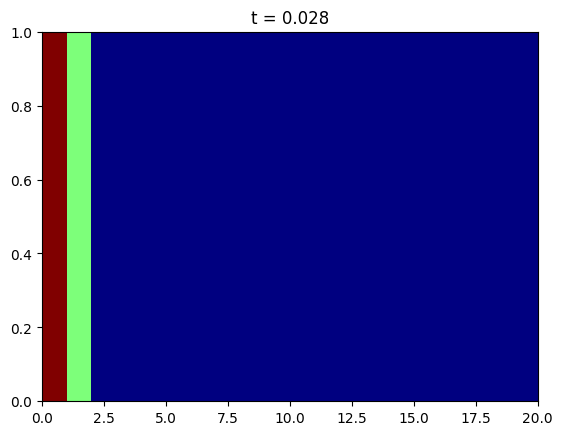

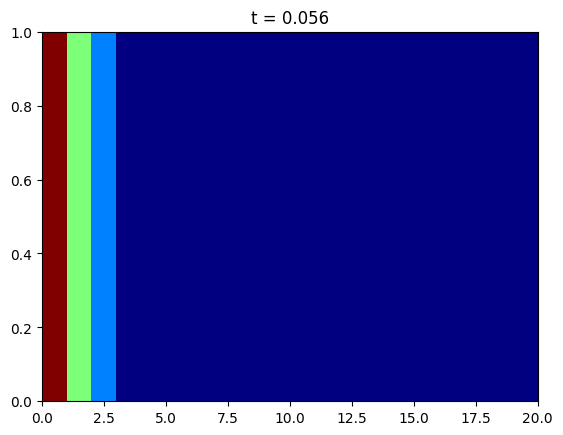

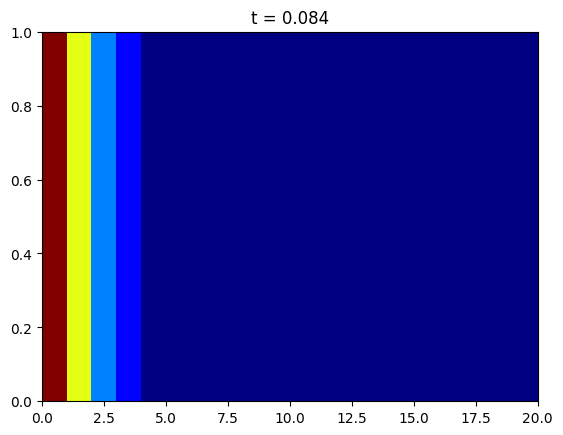

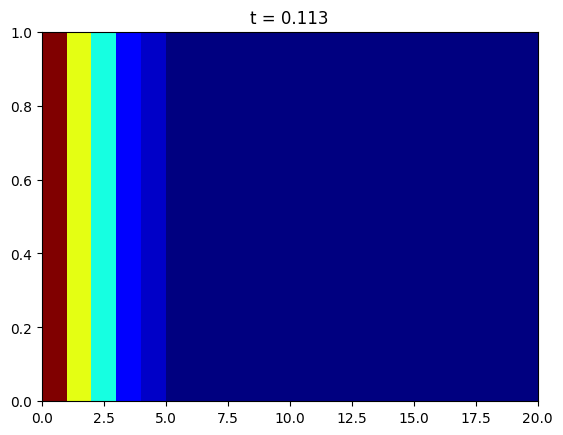

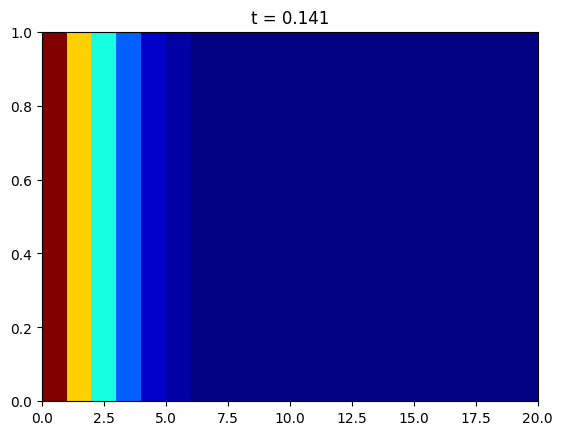

...

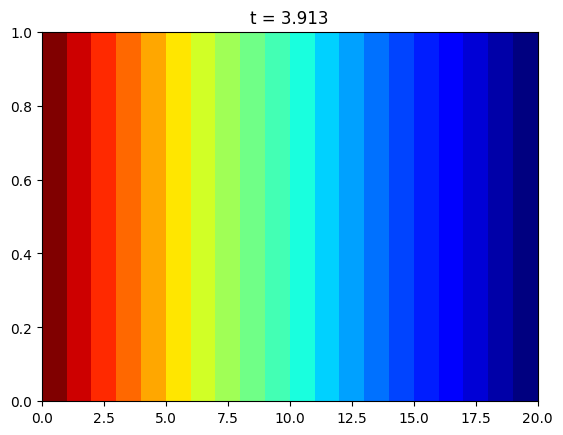

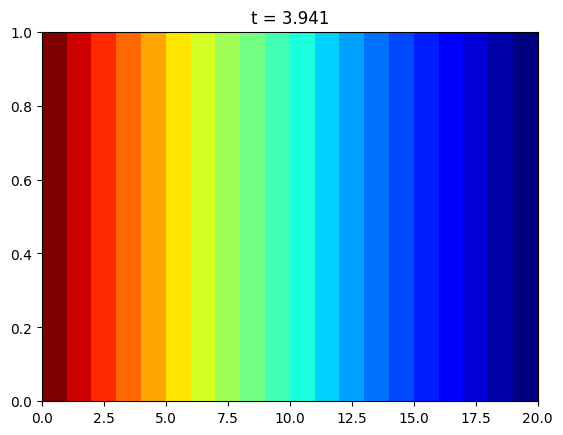

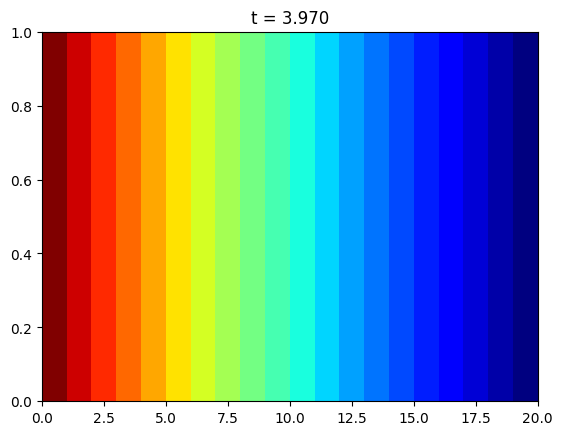

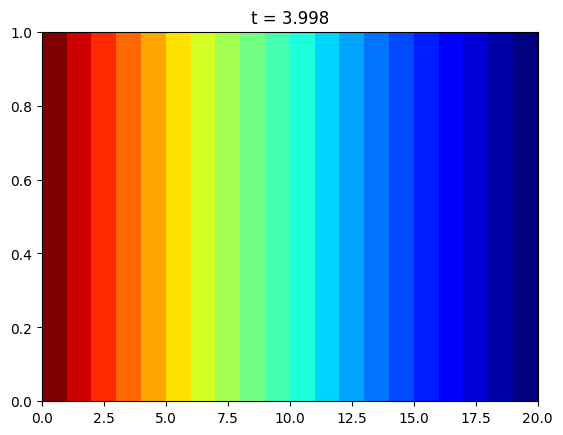

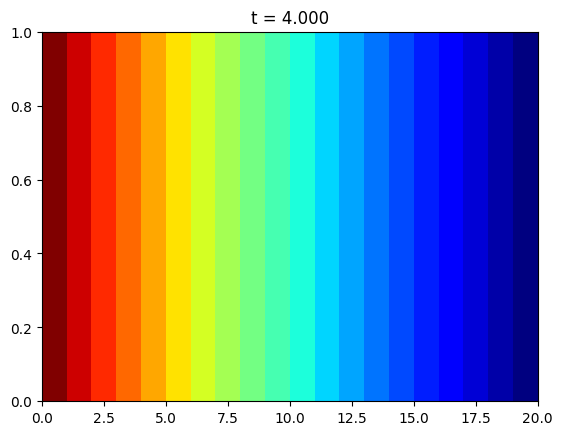

<Figure size 640x480 with 0 Axes>

In [13]:
# loop time
t = t_start
    
while t < t_end:
    if t + dt > t_end:
        dt = t_end - t
    t += dt
    
    # time evolving temperature
    W = T.copy()
    
    for i in range(1, N-1):
        T[i] = W[i] + alph_therm * dt / dx**2 * (W[i+1] - 2.*W[i] + W[i-1])
    
    #T_new[0] = 100 * u.uK  # keep boundary fixed
    #T_new[-1] = 0 * u.uK  # keep boundary fixed
        
    plt.title('t = %.3f' %(t.value))
    plt.pcolormesh([T], cmap='jet', vmax=T.max().value, vmin=0)
    #plt.plot(x_mid, T)
    plt.show(), plt.clf()


0.031478217073784946 s


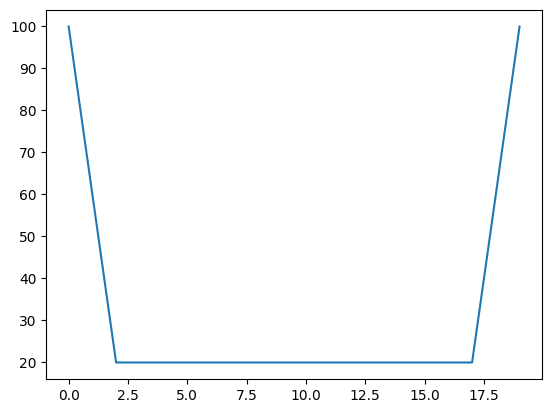

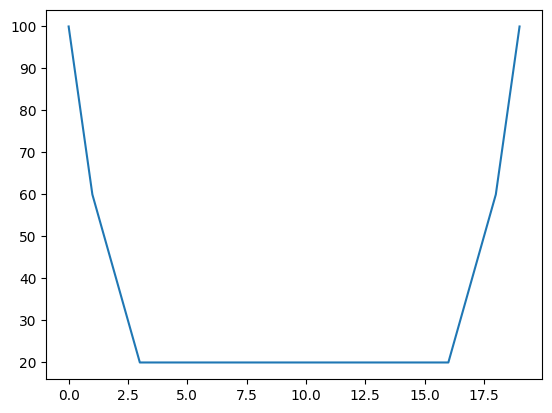

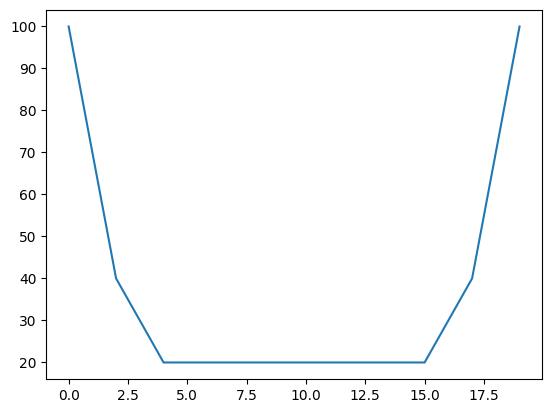

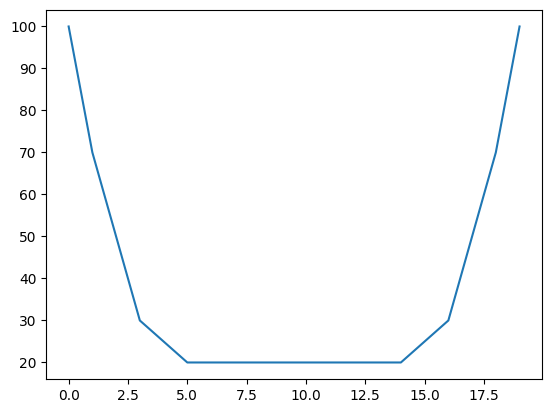

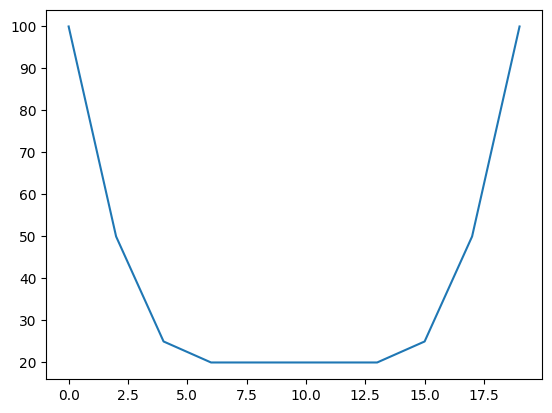

...

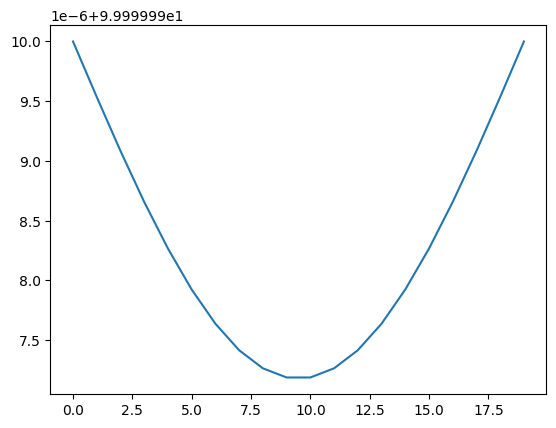

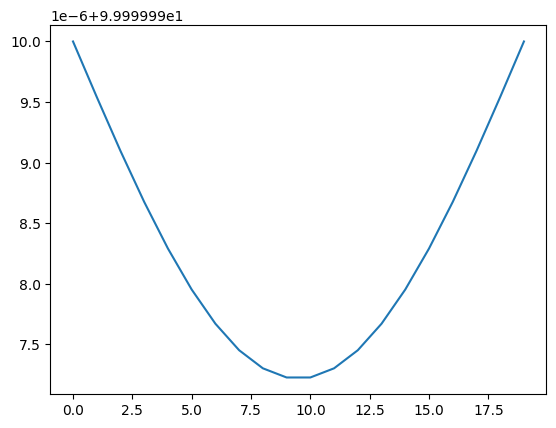

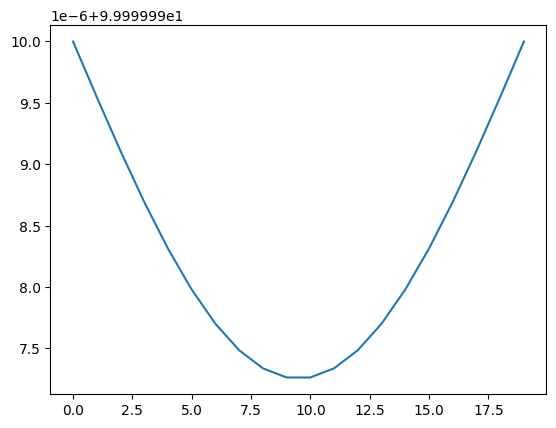

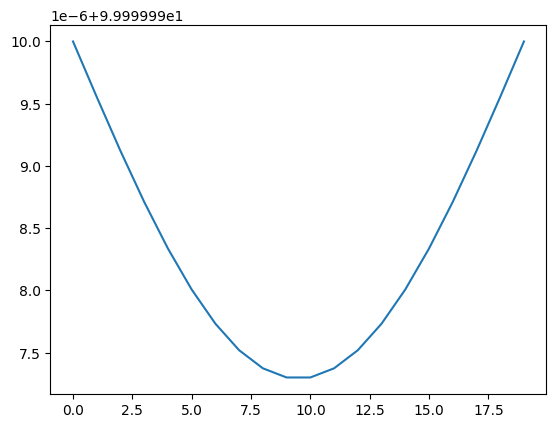

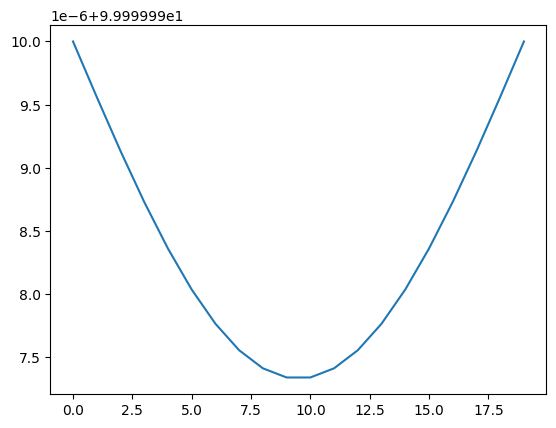

<Figure size 640x480 with 0 Axes>

In [20]:
import numpy as np
import matplotlib.pyplot as plt
import astropy.units as u

# Defining our problem

a = 110 * u.mm**2/u.s
length = 50 * u.mm
time = 40 * u.s
nodes = 20
dx = length / (nodes-1)
dt = (0.5 * dx**2 / a).cgs
print(dt)
t_nodes = int(time/dt) + 1

T = (np.zeros(nodes) + 20) * u.K
# Boundary Conditions 

T[0] = 100* u.K
T[-1] = 100* u.K


# Visualizing with a plot

fig, axis = plt.subplots()

# Simulating

counter = 0

while counter < time :

    w = T.copy()

    for i in range(1, nodes - 1):

        T[i] = dt * a * (w[i - 1] - 2 * w[i] + w[i + 1]) / dx ** 2 + w[i]

    counter += dt

    #print("t: {:.3f} [s], Average temperature: {:.2f} Celcius".format(counter, np.average(u)))
    plt.plot(T)
    plt.show(), plt.clf()

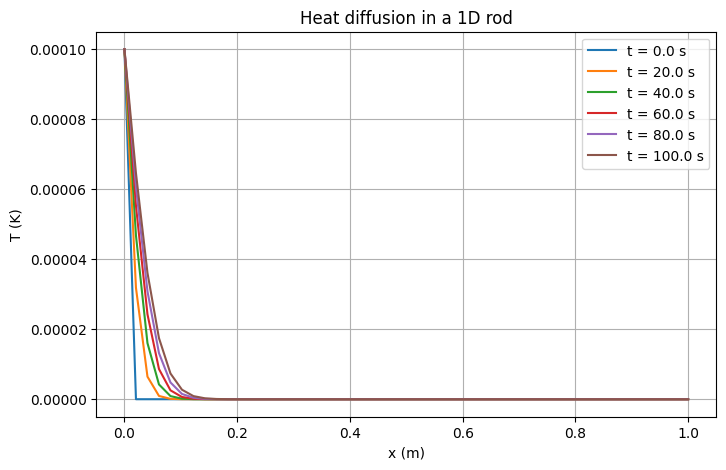

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from astropy import units as u

# Physical parameters
L = 1.0 * u.m  # length of the rod
nx = 50  # number of spatial points
dx = (L / (nx - 1)).to(u.m)

alpha = (1e-5 * u.m**2 / u.s)  # thermal diffusivity

# Time parameters
dt = 0.1 * u.s
nt = 1000  # number of time steps

# Temperature array
T = np.zeros(nx) * u.K
T[0] = 100 * u.uK  # boundary condition at x=0

# Store temperature evolution
T_all = [T.copy()]

# Finite difference loop
for n in range(nt):
    T_new = T.copy()
    for i in range(1, nx - 1):
        T_new[i] = T[i] + alpha * dt / dx**2 * (T[i+1] - 2*T[i] + T[i-1])
    T_new[0] = 100 * u.uK  # keep boundary fixed
    T_new[-1] = 0 * u.K
    T = T_new
    T_all.append(T.copy())

# Plot result
x = np.linspace(0, L.value, nx)
plt.figure(figsize=(8, 5))
for i in range(0, nt+1, nt//5):
    plt.plot(x, T_all[i].value, label=f't = {i*dt:.1f}')
plt.xlabel('x (m)')
plt.ylabel('T (K)')
plt.title('Heat diffusion in a 1D rod')
plt.legend()
plt.grid()
plt.show()


In [3]:
molecular_weight = 1.33
n_gas = (cosmo.Ob0 * cosmo.critical_density0 / (molecular_weight*cst.m_p)).cgs

n_H = t2c.abu_h*n_gas
n_He = t2c.abu_he*n_gas

In [7]:
# Simulation parameters
N = 128 # resolution
boxsize = 1. * u.m
dx = boxsize/N
vol = dx**3
area = dx**2
gamma = 5./3     # adiabatic index for ideal gas
molecular_weight = 1.33

# mesh grid
x_mid = np.linspace(0.5*dx, boxsize-0.5*dx, N)
#X, Y = np.array(np.meshgrid(x_mid, x_mid))
X = x_mid

# Time
t_start = 0 * u.s
t_end = 1e5 * u.s
Nt = 1000
time = np.linspace(t_start, t_end, Nt)

# Initial Conditions
T0 = np.zeros(N) * u.K
T0[0] = 5e2 * u.K
T0[1] = 5e2 * u.K
#T0[N//2] = 5e2 * u.K
#T0[N//2+1] = 5e2 * u.K

rho0 = np.ones(N) * 1e-9 * u.g/u.cm**3
v0 = np.ones(N)* 0.1 * u.m/u.s
p0 = (rho0 * cst.k_B * T0/molecular_weight/cst.m_p).to('g/(m*s**2)')
E = (p0/(gamma - 1.) + 0.5*rho0*np.linalg.norm(v0)**2).to('J/cm**3')


In [8]:
area

<Quantity 6.10351562e-05 m2>

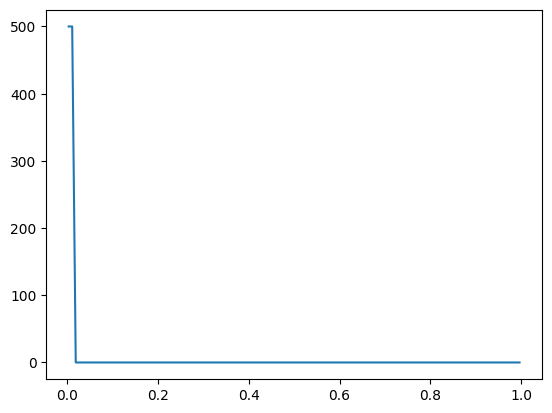

In [9]:
plt.plot(x_mid, T0)

In [10]:
def energy_density(rho, v, P, gamma, vol):
    energy = P/(gamma-1) + 0.5*rho*np.linalg.norm(v)**2
    return energy

#P = (energy/vol - 0.5*rho*np.linalg.norm(v)**2) * (gamma-1)


In [11]:
# loop time
for n, t in enumerate(time):
    dt = time[n+1]-time[n]
    
    # time evolving temperature
    if(n == 0):
        T_now = T0
        T_after = np.zeros_like(T_now)
        
    # loop position 1D
    for i, x_half in enumerate(X):
        T_after[i] = T_now[i] - cst.k_B * dt * area / dx *(T_now[i] - T_now[i-1] - T_now[i+1])
        print(T_after[i])
    plt.title('t = %.3f' %(time[n]))
    plt.plot(x_mid, T_after)
    plt.show(), plt.clf()

UnitConversionError: Can only apply 'subtract' function to quantities with compatible dimensions

In [67]:
(cst.k_B * dt * area / dx).cgs #.to('W/K')

<Quantity 333164.23198264 cm4 P / K>

In [57]:
cst.k_B.cgs

<Quantity 1.380649e-16 erg / K>

In [66]:
u.dyn??